In [1]:
%matplotlib inline 
import json
import numpy as np
import operator
import os
import pandas
import pylab as plt
import random
from ase.data import reference_states, atomic_numbers
from sklearn.neighbors import KernelDensity
from pyiron_atomistics import Project

/scratch/janssen/melt_fe/.snakemake/conda/55607399/lib/python3.9/site-packages/sklearn/utils/deprecation.py:143: FutureWarning: The sklearn.neighbors.kde module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.neighbors. Anything that cannot be imported from sklearn.neighbors is now part of the private API.
  warnings.warn(message, FutureWarning)


In [2]:
import matplotlib as mpl
mpl.rc('font', family='Times New Roman')
plt.rcParams["mathtext.fontset"] = "stix"

In [3]:
from pyiron_atomistics.thermodynamics.interfacemethod import freeze_one_half, remove_selective_dynamics, set_server, create_job_template, fix_iso, fix_z_dir, half_velocity, minimize_pos, minimize_vol, next_calc, npt_solid, npt_liquid, next_step_funct, round_temperature_next, strain_circle, analyse_minimized_structure, get_press, get_center_point, get_strain_lst, get_nve_job_name, plot_solid_liquid_ratio, ratio_selection, plot_equilibration, plot_melting_point_prediction, calc_temp_iteration, get_initial_melting_temperature_guess, validate_convergence, initialise_iterators, get_voronoi_volume, check_for_holes

In [4]:
pr = Project('melting')

In [5]:
input_file = os.path.join(pr.path, 'input.json')
output_file = os.path.join(pr.path, 'output.json')

In [6]:
# Parameters
input_file = "input.json"
output_file = "output.json"


In [7]:
pr.job_table()

""


In [8]:
if os.path.exists(input_file) and os.stat(input_file).st_size != 0:
    with open(input_file, 'r') as f:
        input_dict = json.load(f)
else:
    input_dict = {
        "config": [
            "pair_style morse 9.97749\n",
            "pair_coeff * * 0.4174 1.3885 2.845\n"
        ],
        "species": ["Al"],
        "element": "Al"
    }


In [9]:
input_dict

{'config': ['pair_style eam/alloy \n', 'pair_coeff * * Fe-C-Bec07.eam Fe C\n'],
 'filename': './examples/bccFe/Fe-C-Bec07.eam',
 'species': ['Fe', 'C'],
 'element': 'Fe',
 'cpu_cores': 4}

In [10]:
pot_dict = input_dict.copy()

In [11]:
if 'model' not in pot_dict.keys():
    pot_dict['model'] = 'Lammps'
if 'name' not in pot_dict.keys():
    pot_dict['name'] = 'CustomPotential'
if 'filename' not in pot_dict.keys():
    pot_path = []
else:
    pot_path = [os.path.abspath(pot_dict['filename'])]
potential = pandas.DataFrame({'Config': [pot_dict['config']],
                             'Filename': [pot_path],
                             'Model': [pot_dict['model']],
                             'Name': [pot_dict['name']],
                             'Species': [pot_dict['species']]
                             })

In [12]:
project_parameter = {
    'project': pr,
    'run_time_steps': 50000,
    'nvt_run_time_steps': 10000,
    'nve_run_time_steps': 10000,
    'temperature_left': 0,
    'temperature_right': 1000,
    'strain_run_time_steps': 1000,
    'convergence_criterion': 1,
    'potential': potential,
    'cpu_cores': 1, 
    'job_type': pr.job_type.Lammps,
    'enable_h5md': False,
    'points': 21,
    'boundary_value': 0.25,
    'ratio_boundary': 0.25,
    'timestep_lst': [2, 2, 1],
    'fit_range_lst': [0.05, 0.01, 0.01],
    'nve_run_time_steps_lst': [25000, 20000, 50000],
    'number_of_atoms': 8000, 
}

In [13]:
for k in input_dict.keys():
    project_parameter[k] = input_dict[k]

In [14]:
if 'crystalstructure' not in project_parameter.keys():
    project_parameter['crystalstructure'] = reference_states[atomic_numbers[project_parameter['element']]]['symmetry']

In [15]:
if 'seed' not in project_parameter.keys():
    project_parameter['seed'] = random.randint(0,99999)
project_parameter['seed']

94801

In [16]:
# Values from a previous calculation can be inserted here to reproduce the results 
step_dict = {}
if os.path.exists(output_file):
    with open(output_file, 'r') as f:
        step_dict_str = json.load(f)
    for k,v in step_dict_str.items():
        step_dict[int(k)] = v
step_dict

{}

# From here on the notebook is automated - no change required !

In [17]:
step_count = 0
temperature_next = None
enable_iteration = True
convergence_goal_achieved = False

In [18]:
pr = project_parameter['project']

In [19]:
if 'lattice_constant' in project_parameter.keys():
    basis = pr.create_structure(project_parameter['element'], project_parameter['crystalstructure'].lower(), project_parameter['lattice_constant'])
elif project_parameter['crystalstructure'] == 'hcp':
    basis = pr.create_ase_bulk(project_parameter['element'], project_parameter['crystalstructure'].lower(), cubic=False)
else:
    basis = pr.create_ase_bulk(project_parameter['element'], project_parameter['crystalstructure'].lower(), cubic=True)
basis_lst = [basis.repeat([i, i, i]) for i in range(5,30)]
basis = basis_lst[np.argmin([np.abs(len(b)-project_parameter['number_of_atoms']/2) for b in basis_lst])]

In [20]:
basis.analyse_ovito_cna_adaptive()

{'CommonNeighborAnalysis.counts.OTHER': 0,
 'CommonNeighborAnalysis.counts.FCC': 0,
 'CommonNeighborAnalysis.counts.HCP': 0,
 'CommonNeighborAnalysis.counts.BCC': 4394,
 'CommonNeighborAnalysis.counts.ICO': 0}

In [21]:
basis.plot3d()

NGLWidget()

In [22]:
# pr.remove_jobs(recursive=True)

In [23]:
timestep_iter, fit_range_iter, nve_run_time_steps_iter = initialise_iterators(project_parameter)
timestep = next(timestep_iter)
fit_range = next(fit_range_iter)
nve_run_time_steps = next(nve_run_time_steps_iter)

In [24]:
pr.job_table()

""


# Step 1: set up the solid sample and roughly estimate a melting point

In [25]:
ham_minimize_pos= minimize_pos(
    structure=basis, 
    project_parameter=project_parameter
)

/scratch/janssen/melt_fe/.snakemake/conda/55607399/lib/python3.9/site-packages/pyiron/lammps/interactive.py:245: UserWarning: e_tol is deprecated as of vers. 0.3.0. It is not guaranteed to be in service in vers. 0.4.0. Use ionic_energy_tolerance instead.
  warnings.warn(
/scratch/janssen/melt_fe/.snakemake/conda/55607399/lib/python3.9/site-packages/pyiron/lammps/interactive.py:251: UserWarning: f_tol is deprecated as of vers. 0.3.0. It is not guaranteed to be in service in vers. 0.4.0. Use ionic_force_tolerance instead.
  warnings.warn(


The job minimize_pos was saved and received the ID: 1


In [26]:
ham_minimize_vol = minimize_vol(
    structure=ham_minimize_pos.get_structure(), 
    project_parameter=project_parameter
)

/scratch/janssen/melt_fe/.snakemake/conda/55607399/lib/python3.9/site-packages/pyiron/lammps/interactive.py:245: UserWarning: e_tol is deprecated as of vers. 0.3.0. It is not guaranteed to be in service in vers. 0.4.0. Use ionic_energy_tolerance instead.
  warnings.warn(
/scratch/janssen/melt_fe/.snakemake/conda/55607399/lib/python3.9/site-packages/pyiron/lammps/interactive.py:251: UserWarning: f_tol is deprecated as of vers. 0.3.0. It is not guaranteed to be in service in vers. 0.4.0. Use ionic_force_tolerance instead.
  warnings.warn(


The job minimize_vol was saved and received the ID: 2


In [27]:
temperature_next, structure_left = get_initial_melting_temperature_guess(
    project_parameter=project_parameter, 
    ham_minimize_vol=ham_minimize_vol, 
    temperature_next=temperature_next
)

The job temp_heating_1000 was saved and received the ID: 3


The job temp_heating_2000 was saved and received the ID: 4


The job temp_heating_1500_0 was saved and received the ID: 5


The job temp_heating_1750_0 was saved and received the ID: 6


The job temp_heating_1625_0 was saved and received the ID: 7


The job temp_heating_1687_5 was saved and received the ID: 8


The job temp_heating_1718_75 was saved and received the ID: 9


The job temp_heating_1703_125 was saved and received the ID: 10


The job temp_heating_1695_3125 was saved and received the ID: 11


In [28]:
temperature_next   # +/- 100K 

1695

In [29]:
if step_count in step_dict.keys():
    temperature_next = step_dict[step_count]['temperature_next']
else: 
    step_dict[step_count]= {'temperature_next': temperature_next}

In [30]:
step_dict

{0: {'temperature_next': 1695}}

# Step 2: set up the interface structure

The job ham_npt_solid_1695 was saved and received the ID: 12


The job ham_npt_liquid_high_2695 was saved and received the ID: 13


The job ham_npt_liquid_low_1695 was saved and received the ID: 14


2020-12-02 15:44:38,723 - pyiron_log - WARNING - Job 'ham_nve_0_95_1695_0' does not exist and cannot be loaded


The job ham_nvt_0_95_1695_0 was saved and received the ID: 15


2020-12-02 15:46:53,284 - pyiron_log - WARNING - Job 'ham_nve_0_955_1695_0' does not exist and cannot be loaded


The job ham_nvt_0_955_1695_0 was saved and received the ID: 16


2020-12-02 15:49:06,066 - pyiron_log - WARNING - Job 'ham_nve_0_96_1695_0' does not exist and cannot be loaded


The job ham_nvt_0_96_1695_0 was saved and received the ID: 17


2020-12-02 15:51:19,970 - pyiron_log - WARNING - Job 'ham_nve_0_965_1695_0' does not exist and cannot be loaded


The job ham_nvt_0_965_1695_0 was saved and received the ID: 18


2020-12-02 15:53:32,832 - pyiron_log - WARNING - Job 'ham_nve_0_97_1695_0' does not exist and cannot be loaded


The job ham_nvt_0_97_1695_0 was saved and received the ID: 19


2020-12-02 15:55:43,812 - pyiron_log - WARNING - Job 'ham_nve_0_975_1695_0' does not exist and cannot be loaded


The job ham_nvt_0_975_1695_0 was saved and received the ID: 20


2020-12-02 15:57:55,489 - pyiron_log - WARNING - Job 'ham_nve_0_98_1695_0' does not exist and cannot be loaded


The job ham_nvt_0_98_1695_0 was saved and received the ID: 21


2020-12-02 16:00:08,601 - pyiron_log - WARNING - Job 'ham_nve_0_985_1695_0' does not exist and cannot be loaded


The job ham_nvt_0_985_1695_0 was saved and received the ID: 22


2020-12-02 16:02:18,658 - pyiron_log - WARNING - Job 'ham_nve_0_99_1695_0' does not exist and cannot be loaded


The job ham_nvt_0_99_1695_0 was saved and received the ID: 23


2020-12-02 16:04:31,117 - pyiron_log - WARNING - Job 'ham_nve_0_995_1695_0' does not exist and cannot be loaded


The job ham_nvt_0_995_1695_0 was saved and received the ID: 24


2020-12-02 16:06:40,674 - pyiron_log - WARNING - Job 'ham_nve_1_0_1695_0' does not exist and cannot be loaded


The job ham_nvt_1_0_1695_0 was saved and received the ID: 25


2020-12-02 16:08:49,378 - pyiron_log - WARNING - Job 'ham_nve_1_005_1695_0' does not exist and cannot be loaded


The job ham_nvt_1_005_1695_0 was saved and received the ID: 26


2020-12-02 16:10:56,715 - pyiron_log - WARNING - Job 'ham_nve_1_01_1695_0' does not exist and cannot be loaded


The job ham_nvt_1_01_1695_0 was saved and received the ID: 27


2020-12-02 16:13:02,061 - pyiron_log - WARNING - Job 'ham_nve_1_015_1695_0' does not exist and cannot be loaded


The job ham_nvt_1_015_1695_0 was saved and received the ID: 28


2020-12-02 16:15:08,182 - pyiron_log - WARNING - Job 'ham_nve_1_02_1695_0' does not exist and cannot be loaded


The job ham_nvt_1_02_1695_0 was saved and received the ID: 29


2020-12-02 16:17:13,811 - pyiron_log - WARNING - Job 'ham_nve_1_025_1695_0' does not exist and cannot be loaded


The job ham_nvt_1_025_1695_0 was saved and received the ID: 30


2020-12-02 16:19:21,098 - pyiron_log - WARNING - Job 'ham_nve_1_03_1695_0' does not exist and cannot be loaded


The job ham_nvt_1_03_1695_0 was saved and received the ID: 31


2020-12-02 16:21:26,119 - pyiron_log - WARNING - Job 'ham_nve_1_035_1695_0' does not exist and cannot be loaded


The job ham_nvt_1_035_1695_0 was saved and received the ID: 32


2020-12-02 16:23:34,353 - pyiron_log - WARNING - Job 'ham_nve_1_04_1695_0' does not exist and cannot be loaded


The job ham_nvt_1_04_1695_0 was saved and received the ID: 33


2020-12-02 16:25:35,566 - pyiron_log - WARNING - Job 'ham_nve_1_045_1695_0' does not exist and cannot be loaded


The job ham_nvt_1_045_1695_0 was saved and received the ID: 34


2020-12-02 16:27:36,715 - pyiron_log - WARNING - Job 'ham_nve_1_05_1695_0' does not exist and cannot be loaded


The job ham_nvt_1_05_1695_0 was saved and received the ID: 35


The job ham_nve_0_95_1695_0 was saved and received the ID: 36


The job ham_nve_0_955_1695_0 was saved and received the ID: 37


The job ham_nve_0_96_1695_0 was saved and received the ID: 38


The job ham_nve_0_965_1695_0 was saved and received the ID: 39


The job ham_nve_0_97_1695_0 was saved and received the ID: 40


The job ham_nve_0_975_1695_0 was saved and received the ID: 41


The job ham_nve_0_98_1695_0 was saved and received the ID: 42


The job ham_nve_0_985_1695_0 was saved and received the ID: 43


The job ham_nve_0_99_1695_0 was saved and received the ID: 44


The job ham_nve_0_995_1695_0 was saved and received the ID: 45


The job ham_nve_1_0_1695_0 was saved and received the ID: 46


The job ham_nve_1_005_1695_0 was saved and received the ID: 47


The job ham_nve_1_01_1695_0 was saved and received the ID: 48


The job ham_nve_1_015_1695_0 was saved and received the ID: 49


The job ham_nve_1_02_1695_0 was saved and received the ID: 50


The job ham_nve_1_025_1695_0 was saved and received the ID: 51


The job ham_nve_1_03_1695_0 was saved and received the ID: 52


The job ham_nve_1_035_1695_0 was saved and received the ID: 53


The job ham_nve_1_04_1695_0 was saved and received the ID: 54


The job ham_nve_1_045_1695_0 was saved and received the ID: 55


The job ham_nve_1_05_1695_0 was saved and received the ID: 56


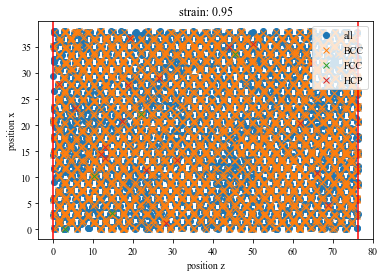

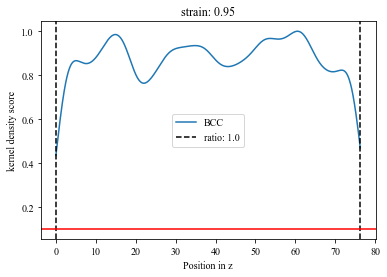

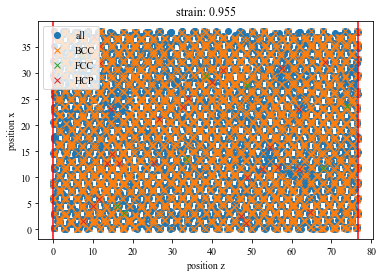

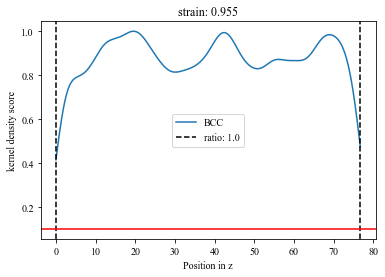

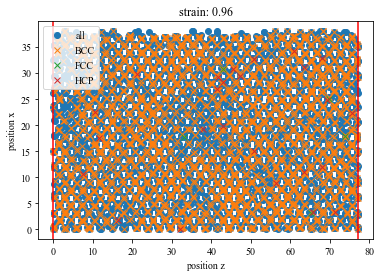

...

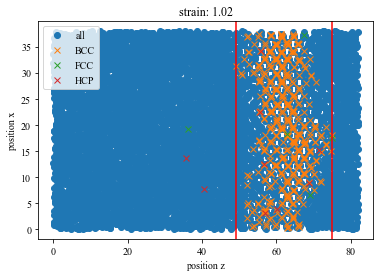

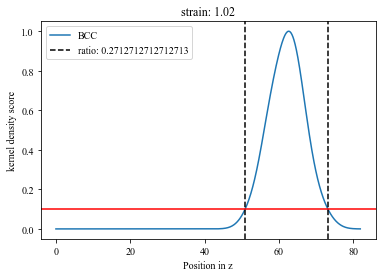

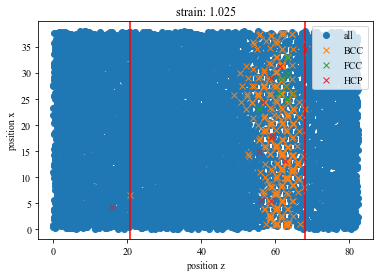

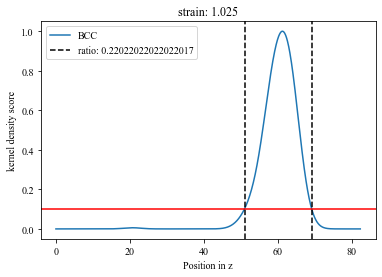

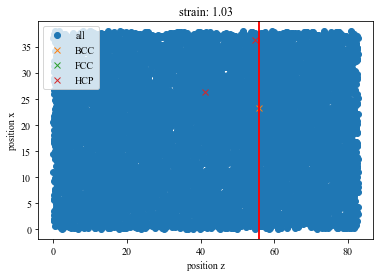

No handles with labels found to put in legend.


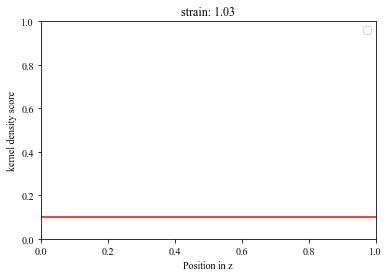

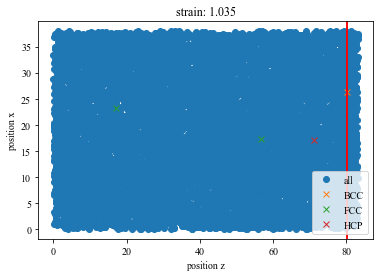

No handles with labels found to put in legend.


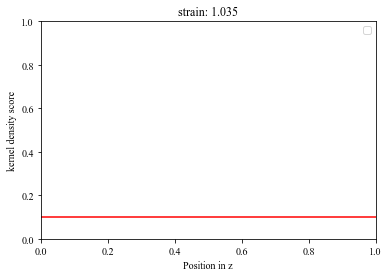

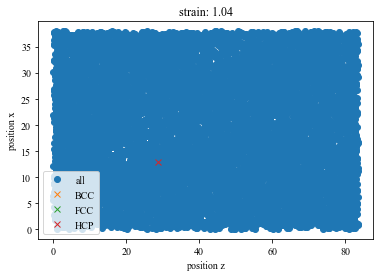

No handles with labels found to put in legend.


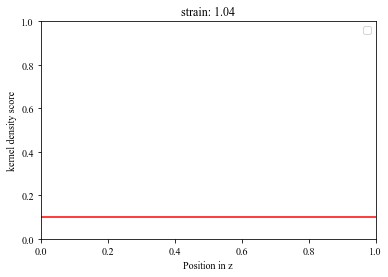

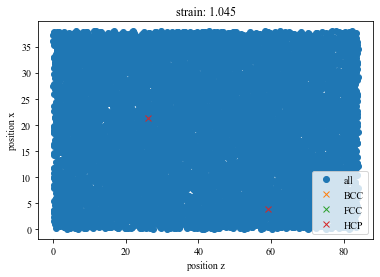

No handles with labels found to put in legend.


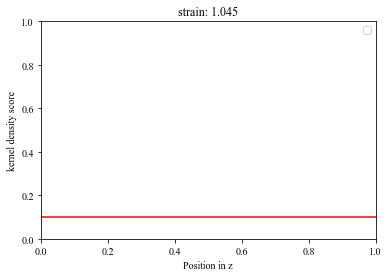

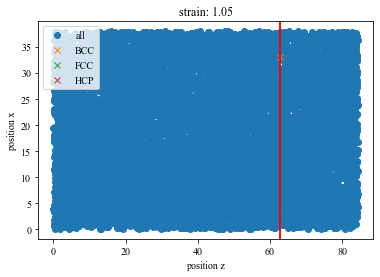

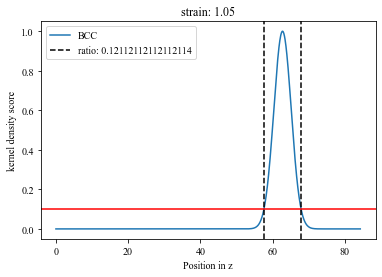

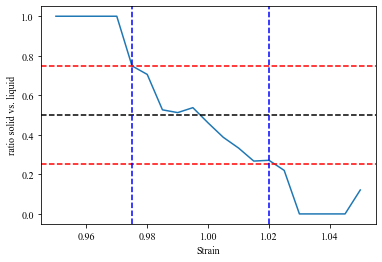

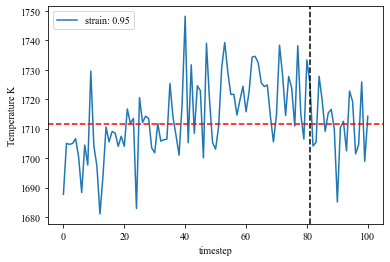

...

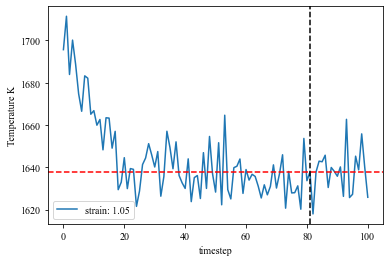

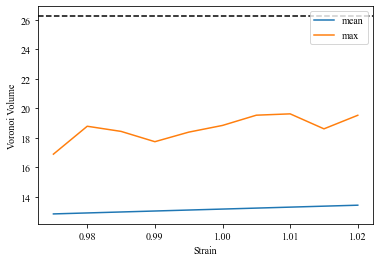

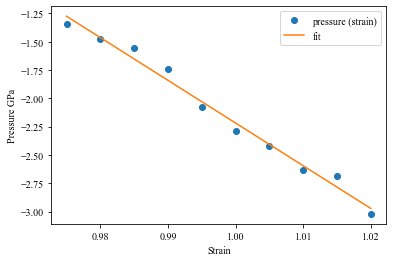

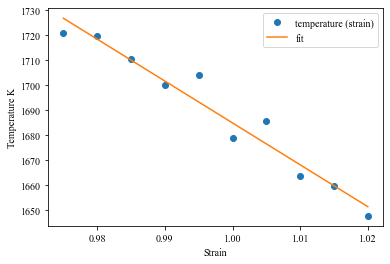

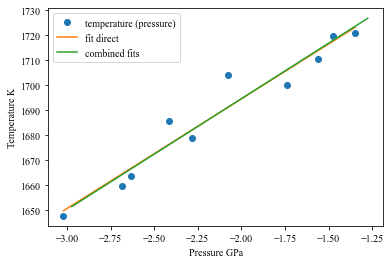

1782.2336552695308 1783.3682762119327


In [31]:
temperature_next, temperature_mean, temperature_left, temperature_right, strain_result_lst, pressure_result_lst = calc_temp_iteration(
        basis=ham_minimize_vol.get_structure().repeat([1,1,2]), 
        temperature_next=temperature_next, 
        project_parameter=project_parameter,
        timestep = timestep,
        nve_run_time_steps=nve_run_time_steps, 
        fit_range=fit_range,  
        center=None,
        debug_plot=True)

In [32]:
temperature_next, temperature_mean, temperature_left, temperature_right

(1782.2336552695308,
 1684.3792177530772,
 1666.0365307561935,
 1702.7219047499611)

# Step 3: run NVT and NVE MD

In [33]:
output = validate_convergence(
    pr=pr,
    temperature_left=temperature_left,
    temperature_next=temperature_next,
    temperature_right=temperature_right,
    enable_iteration=enable_iteration,
    timestep_iter=timestep_iter,
    timestep_lst=project_parameter['timestep_lst'],
    timestep=timestep,
    fit_range_iter=fit_range_iter,
    fit_range_lst=project_parameter['fit_range_lst'],
    fit_range=fit_range,
    nve_run_time_steps_iter=nve_run_time_steps_iter,
    nve_run_time_steps_lst=project_parameter['nve_run_time_steps_lst'],
    nve_run_time_steps=nve_run_time_steps,
    strain_result_lst=strain_result_lst,
    pressure_result_lst=pressure_result_lst,
    step_count=step_count,
    step_dict=step_dict,
    boundary_value=project_parameter['boundary_value'],
    ratio_boundary=project_parameter['ratio_boundary'],
    convergence_goal=project_parameter['convergence_criterion'],
    output_file=output_file
)
convergence_goal_achieved, enable_iteration, step_count, step_dict, timestep, fit_range, nve_run_time_steps, boundary_value, ratio_boundary, temperature_next, center = output

In [34]:
step_dict[step_count]

{'timestep': 2,
 'fit_range': 0.05,
 'nve_run_time_steps': 25000,
 'boundary_value': 0.25,
 'ratio_boundary': 0.25,
 'temperature_next': 1782.2336552695308,
 'center': 0.94}

In [35]:
convergence_goal_achieved

False

# Step 4: full cycle, predict the final melting point

The job ham_npt_solid_1782_23 was saved and received the ID: 57


The job ham_npt_liquid_high_2782_23 was saved and received the ID: 58


The job ham_npt_liquid_low_1782_23 was saved and received the ID: 59


2020-12-02 18:54:44,383 - pyiron_log - WARNING - Job 'ham_nve_0_89_1782_23_0' does not exist and cannot be loaded


The job ham_nvt_0_89_1782_23_0 was saved and received the ID: 60


2020-12-02 18:57:04,776 - pyiron_log - WARNING - Job 'ham_nve_0_895_1782_23_0' does not exist and cannot be loaded


The job ham_nvt_0_895_1782_23_0 was saved and received the ID: 61


2020-12-02 18:59:25,112 - pyiron_log - WARNING - Job 'ham_nve_0_9_1782_23_0' does not exist and cannot be loaded


The job ham_nvt_0_9_1782_23_0 was saved and received the ID: 62


2020-12-02 19:01:49,674 - pyiron_log - WARNING - Job 'ham_nve_0_905_1782_23_0' does not exist and cannot be loaded


The job ham_nvt_0_905_1782_23_0 was saved and received the ID: 63


2020-12-02 19:04:07,970 - pyiron_log - WARNING - Job 'ham_nve_0_91_1782_23_0' does not exist and cannot be loaded


The job ham_nvt_0_91_1782_23_0 was saved and received the ID: 64


2020-12-02 19:06:24,784 - pyiron_log - WARNING - Job 'ham_nve_0_915_1782_23_0' does not exist and cannot be loaded


The job ham_nvt_0_915_1782_23_0 was saved and received the ID: 65


2020-12-02 19:08:46,167 - pyiron_log - WARNING - Job 'ham_nve_0_92_1782_23_0' does not exist and cannot be loaded


The job ham_nvt_0_92_1782_23_0 was saved and received the ID: 66


2020-12-02 19:10:55,993 - pyiron_log - WARNING - Job 'ham_nve_0_925_1782_23_0' does not exist and cannot be loaded


The job ham_nvt_0_925_1782_23_0 was saved and received the ID: 67


2020-12-02 19:13:06,905 - pyiron_log - WARNING - Job 'ham_nve_0_93_1782_23_0' does not exist and cannot be loaded


The job ham_nvt_0_93_1782_23_0 was saved and received the ID: 68


2020-12-02 19:15:26,852 - pyiron_log - WARNING - Job 'ham_nve_0_935_1782_23_0' does not exist and cannot be loaded


The job ham_nvt_0_935_1782_23_0 was saved and received the ID: 69


2020-12-02 19:17:43,287 - pyiron_log - WARNING - Job 'ham_nve_0_94_1782_23_0' does not exist and cannot be loaded


The job ham_nvt_0_94_1782_23_0 was saved and received the ID: 70


2020-12-02 19:20:01,393 - pyiron_log - WARNING - Job 'ham_nve_0_945_1782_23_0' does not exist and cannot be loaded


The job ham_nvt_0_945_1782_23_0 was saved and received the ID: 71


2020-12-02 19:22:11,174 - pyiron_log - WARNING - Job 'ham_nve_0_95_1782_23_0' does not exist and cannot be loaded


The job ham_nvt_0_95_1782_23_0 was saved and received the ID: 72


2020-12-02 19:24:21,417 - pyiron_log - WARNING - Job 'ham_nve_0_955_1782_23_0' does not exist and cannot be loaded


The job ham_nvt_0_955_1782_23_0 was saved and received the ID: 73


2020-12-02 19:26:37,376 - pyiron_log - WARNING - Job 'ham_nve_0_96_1782_23_0' does not exist and cannot be loaded


The job ham_nvt_0_96_1782_23_0 was saved and received the ID: 74


2020-12-02 19:28:50,877 - pyiron_log - WARNING - Job 'ham_nve_0_965_1782_23_0' does not exist and cannot be loaded


The job ham_nvt_0_965_1782_23_0 was saved and received the ID: 75


2020-12-02 19:31:05,003 - pyiron_log - WARNING - Job 'ham_nve_0_97_1782_23_0' does not exist and cannot be loaded


The job ham_nvt_0_97_1782_23_0 was saved and received the ID: 76


2020-12-02 19:33:18,426 - pyiron_log - WARNING - Job 'ham_nve_0_975_1782_23_0' does not exist and cannot be loaded


The job ham_nvt_0_975_1782_23_0 was saved and received the ID: 77


2020-12-02 19:35:34,977 - pyiron_log - WARNING - Job 'ham_nve_0_98_1782_23_0' does not exist and cannot be loaded


The job ham_nvt_0_98_1782_23_0 was saved and received the ID: 78


2020-12-02 19:37:45,717 - pyiron_log - WARNING - Job 'ham_nve_0_985_1782_23_0' does not exist and cannot be loaded


The job ham_nvt_0_985_1782_23_0 was saved and received the ID: 79


2020-12-02 19:39:53,635 - pyiron_log - WARNING - Job 'ham_nve_0_99_1782_23_0' does not exist and cannot be loaded


The job ham_nvt_0_99_1782_23_0 was saved and received the ID: 80


The job ham_nve_0_89_1782_23_0 was saved and received the ID: 81


The job ham_nve_0_895_1782_23_0 was saved and received the ID: 82


The job ham_nve_0_9_1782_23_0 was saved and received the ID: 83


The job ham_nve_0_905_1782_23_0 was saved and received the ID: 84


The job ham_nve_0_91_1782_23_0 was saved and received the ID: 85


The job ham_nve_0_915_1782_23_0 was saved and received the ID: 86


The job ham_nve_0_92_1782_23_0 was saved and received the ID: 87


The job ham_nve_0_925_1782_23_0 was saved and received the ID: 88


The job ham_nve_0_93_1782_23_0 was saved and received the ID: 89


The job ham_nve_0_935_1782_23_0 was saved and received the ID: 90


The job ham_nve_0_94_1782_23_0 was saved and received the ID: 91


The job ham_nve_0_945_1782_23_0 was saved and received the ID: 92


The job ham_nve_0_95_1782_23_0 was saved and received the ID: 93


The job ham_nve_0_955_1782_23_0 was saved and received the ID: 94


The job ham_nve_0_96_1782_23_0 was saved and received the ID: 95


The job ham_nve_0_965_1782_23_0 was saved and received the ID: 96


The job ham_nve_0_97_1782_23_0 was saved and received the ID: 97


The job ham_nve_0_975_1782_23_0 was saved and received the ID: 98


The job ham_nve_0_98_1782_23_0 was saved and received the ID: 99


The job ham_nve_0_985_1782_23_0 was saved and received the ID: 100


The job ham_nve_0_99_1782_23_0 was saved and received the ID: 101


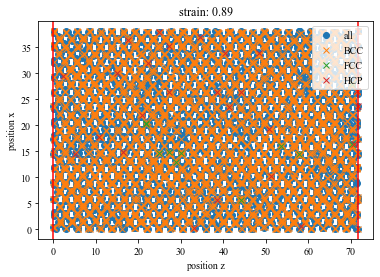

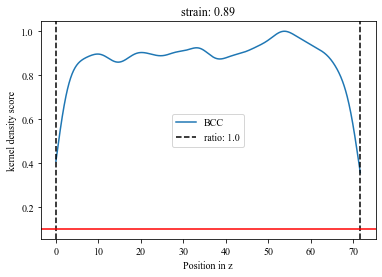

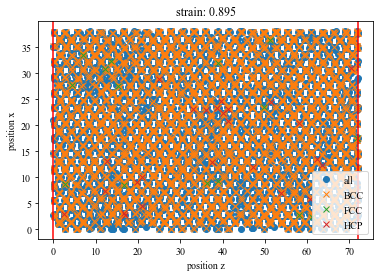

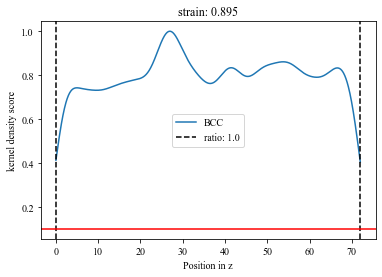

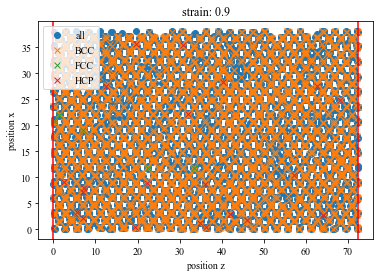

...

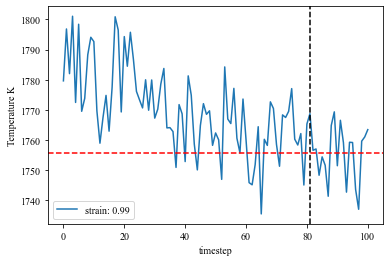

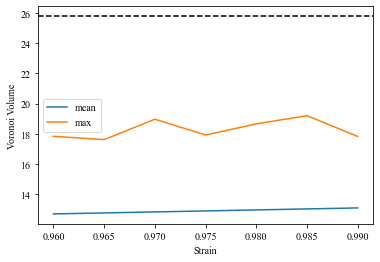

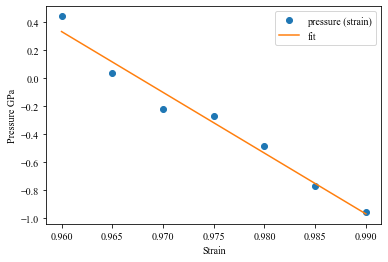

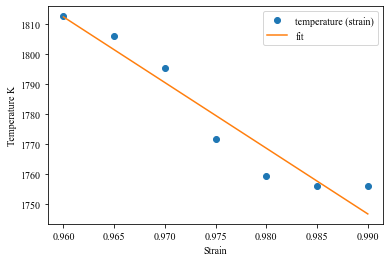

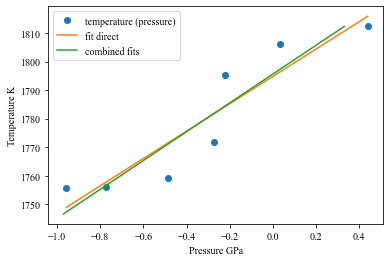

1794.798980794205 1795.6185260142595
1794.798980794205 1784.1289568736192 1769.9431343917445 1798.3147793554942
{'timestep': 2, 'fit_range': 0.01, 'nve_run_time_steps': 20000, 'boundary_value': 0.25, 'ratio_boundary': 0.25, 'temperature_next': 1794.798980794205, 'center': 0.97}


The job ham_npt_solid_1794_8 was saved and received the ID: 102


The job ham_npt_liquid_high_2794_8 was saved and received the ID: 103


The job ham_npt_liquid_low_1794_8 was saved and received the ID: 104


2020-12-02 22:00:02,113 - pyiron_log - WARNING - Job 'ham_nve_0_96_1794_8_1' does not exist and cannot be loaded


The job ham_nvt_0_96_1794_8_1 was saved and received the ID: 105


2020-12-02 22:01:55,513 - pyiron_log - WARNING - Job 'ham_nve_0_961_1794_8_1' does not exist and cannot be loaded


The job ham_nvt_0_961_1794_8_1 was saved and received the ID: 106


2020-12-02 22:03:51,200 - pyiron_log - WARNING - Job 'ham_nve_0_962_1794_8_1' does not exist and cannot be loaded


The job ham_nvt_0_962_1794_8_1 was saved and received the ID: 107


2020-12-02 22:05:43,696 - pyiron_log - WARNING - Job 'ham_nve_0_963_1794_8_1' does not exist and cannot be loaded


The job ham_nvt_0_963_1794_8_1 was saved and received the ID: 108


2020-12-02 22:07:43,066 - pyiron_log - WARNING - Job 'ham_nve_0_964_1794_8_1' does not exist and cannot be loaded


The job ham_nvt_0_964_1794_8_1 was saved and received the ID: 109


2020-12-02 22:09:35,212 - pyiron_log - WARNING - Job 'ham_nve_0_965_1794_8_1' does not exist and cannot be loaded


The job ham_nvt_0_965_1794_8_1 was saved and received the ID: 110


2020-12-02 22:11:32,783 - pyiron_log - WARNING - Job 'ham_nve_0_966_1794_8_1' does not exist and cannot be loaded


The job ham_nvt_0_966_1794_8_1 was saved and received the ID: 111


2020-12-02 22:13:29,779 - pyiron_log - WARNING - Job 'ham_nve_0_967_1794_8_1' does not exist and cannot be loaded


The job ham_nvt_0_967_1794_8_1 was saved and received the ID: 112


2020-12-02 22:15:23,758 - pyiron_log - WARNING - Job 'ham_nve_0_968_1794_8_1' does not exist and cannot be loaded


The job ham_nvt_0_968_1794_8_1 was saved and received the ID: 113


2020-12-02 22:17:21,079 - pyiron_log - WARNING - Job 'ham_nve_0_969_1794_8_1' does not exist and cannot be loaded


The job ham_nvt_0_969_1794_8_1 was saved and received the ID: 114


2020-12-02 22:18:47,381 - pyiron_log - WARNING - Job 'ham_nve_0_97_1794_8_1' does not exist and cannot be loaded


The job ham_nvt_0_97_1794_8_1 was saved and received the ID: 115


2020-12-02 22:20:02,128 - pyiron_log - WARNING - Job 'ham_nve_0_971_1794_8_1' does not exist and cannot be loaded


The job ham_nvt_0_971_1794_8_1 was saved and received the ID: 116


2020-12-02 22:21:16,696 - pyiron_log - WARNING - Job 'ham_nve_0_972_1794_8_1' does not exist and cannot be loaded


The job ham_nvt_0_972_1794_8_1 was saved and received the ID: 117


2020-12-02 22:22:50,376 - pyiron_log - WARNING - Job 'ham_nve_0_973_1794_8_1' does not exist and cannot be loaded


The job ham_nvt_0_973_1794_8_1 was saved and received the ID: 118


2020-12-02 22:24:45,614 - pyiron_log - WARNING - Job 'ham_nve_0_974_1794_8_1' does not exist and cannot be loaded


The job ham_nvt_0_974_1794_8_1 was saved and received the ID: 119


2020-12-02 22:26:41,343 - pyiron_log - WARNING - Job 'ham_nve_0_975_1794_8_1' does not exist and cannot be loaded


The job ham_nvt_0_975_1794_8_1 was saved and received the ID: 120


2020-12-02 22:28:31,481 - pyiron_log - WARNING - Job 'ham_nve_0_976_1794_8_1' does not exist and cannot be loaded


The job ham_nvt_0_976_1794_8_1 was saved and received the ID: 121


2020-12-02 22:30:23,094 - pyiron_log - WARNING - Job 'ham_nve_0_977_1794_8_1' does not exist and cannot be loaded


The job ham_nvt_0_977_1794_8_1 was saved and received the ID: 122


2020-12-02 22:32:16,800 - pyiron_log - WARNING - Job 'ham_nve_0_978_1794_8_1' does not exist and cannot be loaded


The job ham_nvt_0_978_1794_8_1 was saved and received the ID: 123


2020-12-02 22:34:10,739 - pyiron_log - WARNING - Job 'ham_nve_0_979_1794_8_1' does not exist and cannot be loaded


The job ham_nvt_0_979_1794_8_1 was saved and received the ID: 124


2020-12-02 22:36:05,742 - pyiron_log - WARNING - Job 'ham_nve_0_98_1794_8_1' does not exist and cannot be loaded


The job ham_nvt_0_98_1794_8_1 was saved and received the ID: 125


The job ham_nve_0_96_1794_8_1 was saved and received the ID: 126


The job ham_nve_0_961_1794_8_1 was saved and received the ID: 127


The job ham_nve_0_962_1794_8_1 was saved and received the ID: 128


The job ham_nve_0_963_1794_8_1 was saved and received the ID: 129


The job ham_nve_0_964_1794_8_1 was saved and received the ID: 130


The job ham_nve_0_965_1794_8_1 was saved and received the ID: 131


The job ham_nve_0_966_1794_8_1 was saved and received the ID: 132


The job ham_nve_0_967_1794_8_1 was saved and received the ID: 133


The job ham_nve_0_968_1794_8_1 was saved and received the ID: 134


The job ham_nve_0_969_1794_8_1 was saved and received the ID: 135


The job ham_nve_0_97_1794_8_1 was saved and received the ID: 136


The job ham_nve_0_971_1794_8_1 was saved and received the ID: 137


The job ham_nve_0_972_1794_8_1 was saved and received the ID: 138


The job ham_nve_0_973_1794_8_1 was saved and received the ID: 139


The job ham_nve_0_974_1794_8_1 was saved and received the ID: 140


The job ham_nve_0_975_1794_8_1 was saved and received the ID: 141


The job ham_nve_0_976_1794_8_1 was saved and received the ID: 142


The job ham_nve_0_977_1794_8_1 was saved and received the ID: 143


The job ham_nve_0_978_1794_8_1 was saved and received the ID: 144


The job ham_nve_0_979_1794_8_1 was saved and received the ID: 145


The job ham_nve_0_98_1794_8_1 was saved and received the ID: 146


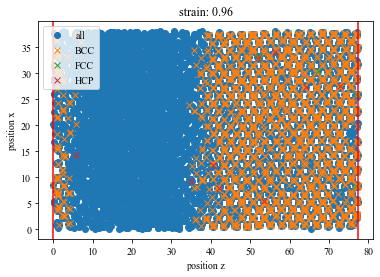

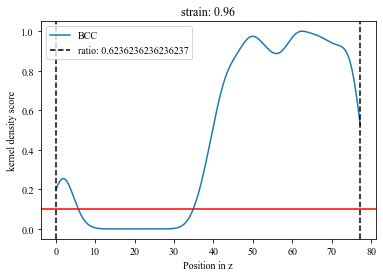

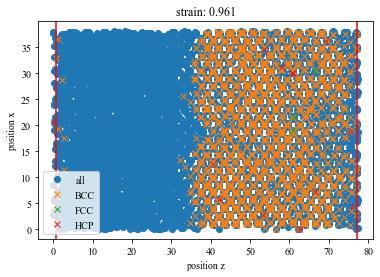

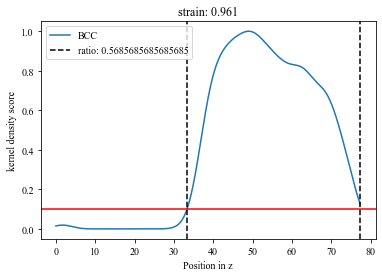

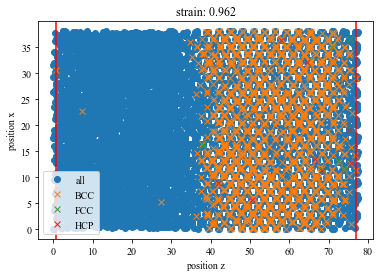

...

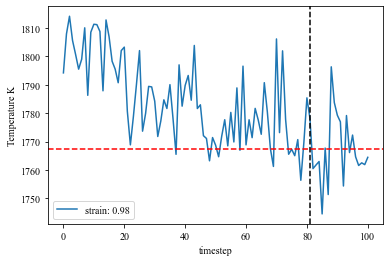

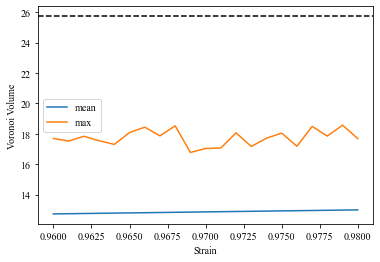

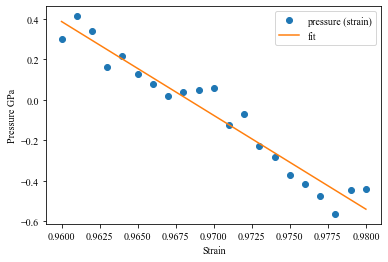

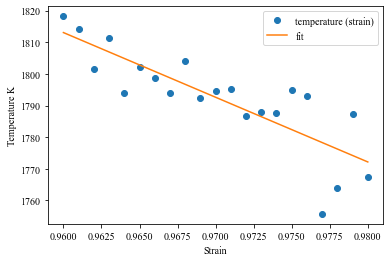

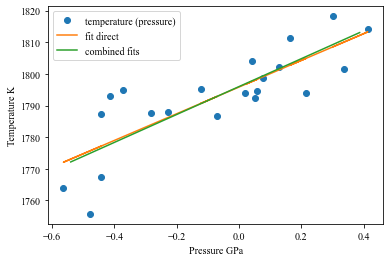

1795.8466527704347 1795.9939795232576
1795.8466527704347 1786.985697098075 1771.3649556609366 1802.6064385352133
{'timestep': 1, 'fit_range': 0.01, 'nve_run_time_steps': 50000, 'boundary_value': 0.25, 'ratio_boundary': 0.25, 'temperature_next': 1795.8466527704347, 'center': 0.97}


The job ham_npt_solid_1795_85 was saved and received the ID: 147


The job ham_npt_liquid_high_2795_85 was saved and received the ID: 148


The job ham_npt_liquid_low_1795_85 was saved and received the ID: 149


2020-12-03 00:36:38,801 - pyiron_log - WARNING - Job 'ham_nve_0_96_1795_85_2' does not exist and cannot be loaded


The job ham_nvt_0_96_1795_85_2 was saved and received the ID: 150


2020-12-03 00:38:52,472 - pyiron_log - WARNING - Job 'ham_nve_0_961_1795_85_2' does not exist and cannot be loaded


The job ham_nvt_0_961_1795_85_2 was saved and received the ID: 151


2020-12-03 00:41:04,487 - pyiron_log - WARNING - Job 'ham_nve_0_962_1795_85_2' does not exist and cannot be loaded


The job ham_nvt_0_962_1795_85_2 was saved and received the ID: 152


2020-12-03 00:43:15,249 - pyiron_log - WARNING - Job 'ham_nve_0_963_1795_85_2' does not exist and cannot be loaded


The job ham_nvt_0_963_1795_85_2 was saved and received the ID: 153


2020-12-03 00:45:27,961 - pyiron_log - WARNING - Job 'ham_nve_0_964_1795_85_2' does not exist and cannot be loaded


The job ham_nvt_0_964_1795_85_2 was saved and received the ID: 154


2020-12-03 00:47:35,149 - pyiron_log - WARNING - Job 'ham_nve_0_965_1795_85_2' does not exist and cannot be loaded


The job ham_nvt_0_965_1795_85_2 was saved and received the ID: 155


2020-12-03 00:49:49,592 - pyiron_log - WARNING - Job 'ham_nve_0_966_1795_85_2' does not exist and cannot be loaded


The job ham_nvt_0_966_1795_85_2 was saved and received the ID: 156


2020-12-03 00:52:05,285 - pyiron_log - WARNING - Job 'ham_nve_0_967_1795_85_2' does not exist and cannot be loaded


The job ham_nvt_0_967_1795_85_2 was saved and received the ID: 157


2020-12-03 00:54:18,170 - pyiron_log - WARNING - Job 'ham_nve_0_968_1795_85_2' does not exist and cannot be loaded


The job ham_nvt_0_968_1795_85_2 was saved and received the ID: 158


2020-12-03 00:56:28,710 - pyiron_log - WARNING - Job 'ham_nve_0_969_1795_85_2' does not exist and cannot be loaded


The job ham_nvt_0_969_1795_85_2 was saved and received the ID: 159


2020-12-03 00:58:43,625 - pyiron_log - WARNING - Job 'ham_nve_0_97_1795_85_2' does not exist and cannot be loaded


The job ham_nvt_0_97_1795_85_2 was saved and received the ID: 160


2020-12-03 01:00:52,796 - pyiron_log - WARNING - Job 'ham_nve_0_971_1795_85_2' does not exist and cannot be loaded


The job ham_nvt_0_971_1795_85_2 was saved and received the ID: 161


2020-12-03 01:03:00,570 - pyiron_log - WARNING - Job 'ham_nve_0_972_1795_85_2' does not exist and cannot be loaded


The job ham_nvt_0_972_1795_85_2 was saved and received the ID: 162


2020-12-03 01:05:14,445 - pyiron_log - WARNING - Job 'ham_nve_0_973_1795_85_2' does not exist and cannot be loaded


The job ham_nvt_0_973_1795_85_2 was saved and received the ID: 163


2020-12-03 01:07:22,478 - pyiron_log - WARNING - Job 'ham_nve_0_974_1795_85_2' does not exist and cannot be loaded


The job ham_nvt_0_974_1795_85_2 was saved and received the ID: 164


2020-12-03 01:09:34,224 - pyiron_log - WARNING - Job 'ham_nve_0_975_1795_85_2' does not exist and cannot be loaded


The job ham_nvt_0_975_1795_85_2 was saved and received the ID: 165


2020-12-03 01:11:40,120 - pyiron_log - WARNING - Job 'ham_nve_0_976_1795_85_2' does not exist and cannot be loaded


The job ham_nvt_0_976_1795_85_2 was saved and received the ID: 166


2020-12-03 01:13:51,355 - pyiron_log - WARNING - Job 'ham_nve_0_977_1795_85_2' does not exist and cannot be loaded


The job ham_nvt_0_977_1795_85_2 was saved and received the ID: 167


2020-12-03 01:16:04,161 - pyiron_log - WARNING - Job 'ham_nve_0_978_1795_85_2' does not exist and cannot be loaded


The job ham_nvt_0_978_1795_85_2 was saved and received the ID: 168


2020-12-03 01:18:18,171 - pyiron_log - WARNING - Job 'ham_nve_0_979_1795_85_2' does not exist and cannot be loaded


The job ham_nvt_0_979_1795_85_2 was saved and received the ID: 169


2020-12-03 01:20:26,949 - pyiron_log - WARNING - Job 'ham_nve_0_98_1795_85_2' does not exist and cannot be loaded


The job ham_nvt_0_98_1795_85_2 was saved and received the ID: 170


The job ham_nve_0_96_1795_85_2 was saved and received the ID: 171


The job ham_nve_0_961_1795_85_2 was saved and received the ID: 172


The job ham_nve_0_962_1795_85_2 was saved and received the ID: 173


The job ham_nve_0_963_1795_85_2 was saved and received the ID: 174


The job ham_nve_0_964_1795_85_2 was saved and received the ID: 175


The job ham_nve_0_965_1795_85_2 was saved and received the ID: 176


The job ham_nve_0_966_1795_85_2 was saved and received the ID: 177


The job ham_nve_0_967_1795_85_2 was saved and received the ID: 178


The job ham_nve_0_968_1795_85_2 was saved and received the ID: 179


The job ham_nve_0_969_1795_85_2 was saved and received the ID: 180


The job ham_nve_0_97_1795_85_2 was saved and received the ID: 181


The job ham_nve_0_971_1795_85_2 was saved and received the ID: 182


The job ham_nve_0_972_1795_85_2 was saved and received the ID: 183


The job ham_nve_0_973_1795_85_2 was saved and received the ID: 184


The job ham_nve_0_974_1795_85_2 was saved and received the ID: 185


The job ham_nve_0_975_1795_85_2 was saved and received the ID: 186


The job ham_nve_0_976_1795_85_2 was saved and received the ID: 187


The job ham_nve_0_977_1795_85_2 was saved and received the ID: 188


The job ham_nve_0_978_1795_85_2 was saved and received the ID: 189


The job ham_nve_0_979_1795_85_2 was saved and received the ID: 190


The job ham_nve_0_98_1795_85_2 was saved and received the ID: 191


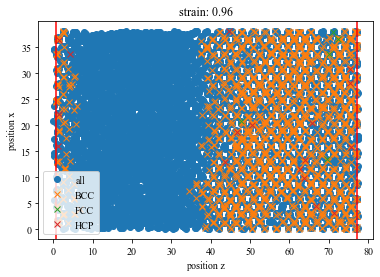

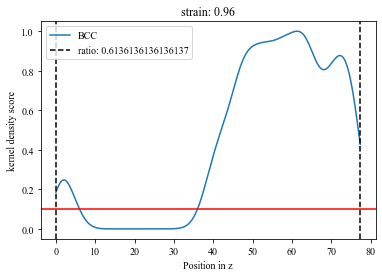

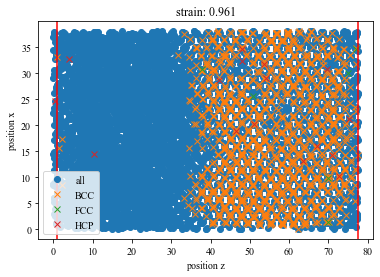

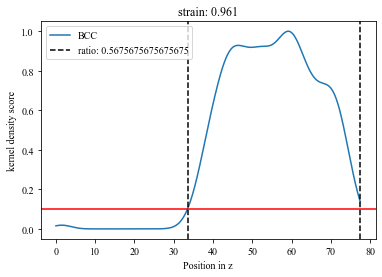

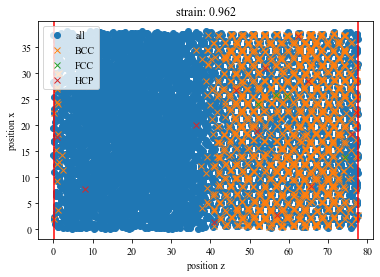

...

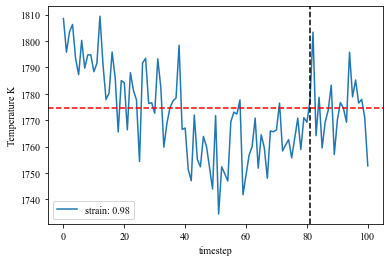

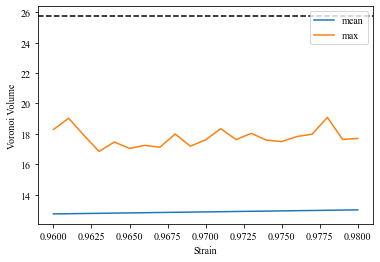

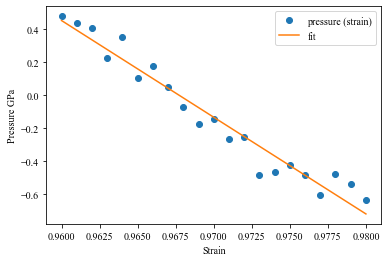

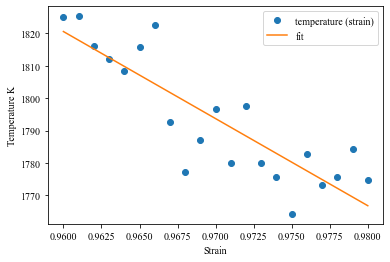

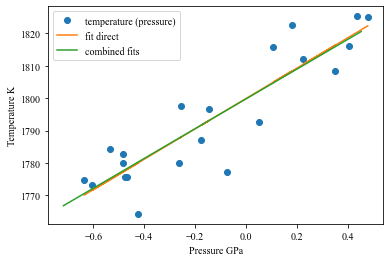

1799.9503442479693 1799.8282598353314
1799.9503442479693 1794.7834071494556 1779.5310764325473 1810.035737866364
{'timestep': 1, 'fit_range': 0.01, 'nve_run_time_steps': 50000, 'boundary_value': 0.25, 'ratio_boundary': 0.25, 'temperature_next': 1799.9503442479693, 'center': 0.97}


The job ham_npt_solid_1799_95 was saved and received the ID: 192


The job ham_npt_liquid_high_2799_95 was saved and received the ID: 193


The job ham_npt_liquid_low_1799_95 was saved and received the ID: 194


2020-12-03 05:29:20,441 - pyiron_log - WARNING - Job 'ham_nve_0_96_1799_95_2' does not exist and cannot be loaded


The job ham_nvt_0_96_1799_95_2 was saved and received the ID: 195


2020-12-03 05:31:11,255 - pyiron_log - WARNING - Job 'ham_nve_0_961_1799_95_2' does not exist and cannot be loaded


The job ham_nvt_0_961_1799_95_2 was saved and received the ID: 196


2020-12-03 05:33:03,777 - pyiron_log - WARNING - Job 'ham_nve_0_962_1799_95_2' does not exist and cannot be loaded


The job ham_nvt_0_962_1799_95_2 was saved and received the ID: 197


2020-12-03 05:34:56,315 - pyiron_log - WARNING - Job 'ham_nve_0_963_1799_95_2' does not exist and cannot be loaded


The job ham_nvt_0_963_1799_95_2 was saved and received the ID: 198


2020-12-03 05:36:48,449 - pyiron_log - WARNING - Job 'ham_nve_0_964_1799_95_2' does not exist and cannot be loaded


The job ham_nvt_0_964_1799_95_2 was saved and received the ID: 199


2020-12-03 05:38:39,179 - pyiron_log - WARNING - Job 'ham_nve_0_965_1799_95_2' does not exist and cannot be loaded


The job ham_nvt_0_965_1799_95_2 was saved and received the ID: 200


2020-12-03 05:40:33,286 - pyiron_log - WARNING - Job 'ham_nve_0_966_1799_95_2' does not exist and cannot be loaded


The job ham_nvt_0_966_1799_95_2 was saved and received the ID: 201


2020-12-03 05:42:28,329 - pyiron_log - WARNING - Job 'ham_nve_0_967_1799_95_2' does not exist and cannot be loaded


The job ham_nvt_0_967_1799_95_2 was saved and received the ID: 202


2020-12-03 05:44:21,667 - pyiron_log - WARNING - Job 'ham_nve_0_968_1799_95_2' does not exist and cannot be loaded


The job ham_nvt_0_968_1799_95_2 was saved and received the ID: 203


2020-12-03 05:46:15,722 - pyiron_log - WARNING - Job 'ham_nve_0_969_1799_95_2' does not exist and cannot be loaded


The job ham_nvt_0_969_1799_95_2 was saved and received the ID: 204


2020-12-03 05:48:09,126 - pyiron_log - WARNING - Job 'ham_nve_0_97_1799_95_2' does not exist and cannot be loaded


The job ham_nvt_0_97_1799_95_2 was saved and received the ID: 205


2020-12-03 05:49:59,147 - pyiron_log - WARNING - Job 'ham_nve_0_971_1799_95_2' does not exist and cannot be loaded


The job ham_nvt_0_971_1799_95_2 was saved and received the ID: 206


2020-12-03 05:51:51,965 - pyiron_log - WARNING - Job 'ham_nve_0_972_1799_95_2' does not exist and cannot be loaded


The job ham_nvt_0_972_1799_95_2 was saved and received the ID: 207


2020-12-03 05:53:44,582 - pyiron_log - WARNING - Job 'ham_nve_0_973_1799_95_2' does not exist and cannot be loaded


The job ham_nvt_0_973_1799_95_2 was saved and received the ID: 208


2020-12-03 05:55:37,503 - pyiron_log - WARNING - Job 'ham_nve_0_974_1799_95_2' does not exist and cannot be loaded


The job ham_nvt_0_974_1799_95_2 was saved and received the ID: 209


2020-12-03 05:57:30,045 - pyiron_log - WARNING - Job 'ham_nve_0_975_1799_95_2' does not exist and cannot be loaded


The job ham_nvt_0_975_1799_95_2 was saved and received the ID: 210


2020-12-03 05:59:22,545 - pyiron_log - WARNING - Job 'ham_nve_0_976_1799_95_2' does not exist and cannot be loaded


The job ham_nvt_0_976_1799_95_2 was saved and received the ID: 211


2020-12-03 06:01:17,683 - pyiron_log - WARNING - Job 'ham_nve_0_977_1799_95_2' does not exist and cannot be loaded


The job ham_nvt_0_977_1799_95_2 was saved and received the ID: 212


2020-12-03 06:03:08,786 - pyiron_log - WARNING - Job 'ham_nve_0_978_1799_95_2' does not exist and cannot be loaded


The job ham_nvt_0_978_1799_95_2 was saved and received the ID: 213


2020-12-03 06:04:59,834 - pyiron_log - WARNING - Job 'ham_nve_0_979_1799_95_2' does not exist and cannot be loaded


The job ham_nvt_0_979_1799_95_2 was saved and received the ID: 214


2020-12-03 06:06:51,039 - pyiron_log - WARNING - Job 'ham_nve_0_98_1799_95_2' does not exist and cannot be loaded


The job ham_nvt_0_98_1799_95_2 was saved and received the ID: 215


The job ham_nve_0_96_1799_95_2 was saved and received the ID: 216


The job ham_nve_0_961_1799_95_2 was saved and received the ID: 217


The job ham_nve_0_962_1799_95_2 was saved and received the ID: 218


The job ham_nve_0_963_1799_95_2 was saved and received the ID: 219


The job ham_nve_0_964_1799_95_2 was saved and received the ID: 220


The job ham_nve_0_965_1799_95_2 was saved and received the ID: 221


The job ham_nve_0_966_1799_95_2 was saved and received the ID: 222


The job ham_nve_0_967_1799_95_2 was saved and received the ID: 223


The job ham_nve_0_968_1799_95_2 was saved and received the ID: 224


The job ham_nve_0_969_1799_95_2 was saved and received the ID: 225


The job ham_nve_0_97_1799_95_2 was saved and received the ID: 226


The job ham_nve_0_971_1799_95_2 was saved and received the ID: 227


The job ham_nve_0_972_1799_95_2 was saved and received the ID: 228


The job ham_nve_0_973_1799_95_2 was saved and received the ID: 229


The job ham_nve_0_974_1799_95_2 was saved and received the ID: 230


The job ham_nve_0_975_1799_95_2 was saved and received the ID: 231


The job ham_nve_0_976_1799_95_2 was saved and received the ID: 232


The job ham_nve_0_977_1799_95_2 was saved and received the ID: 233


The job ham_nve_0_978_1799_95_2 was saved and received the ID: 234


The job ham_nve_0_979_1799_95_2 was saved and received the ID: 235


The job ham_nve_0_98_1799_95_2 was saved and received the ID: 236


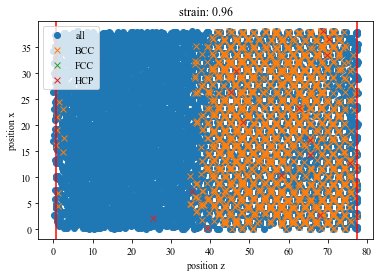

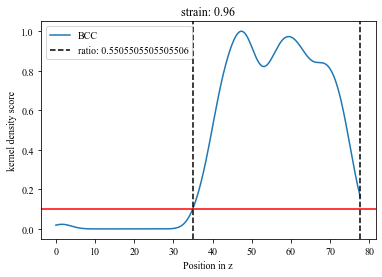

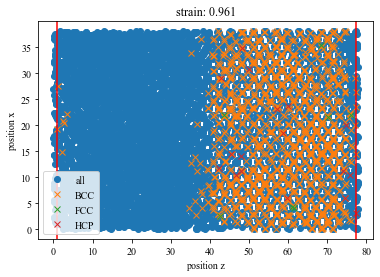

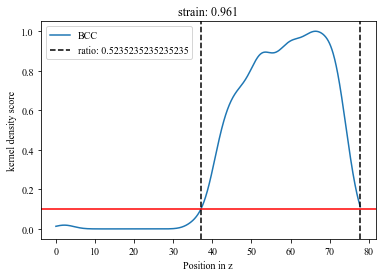

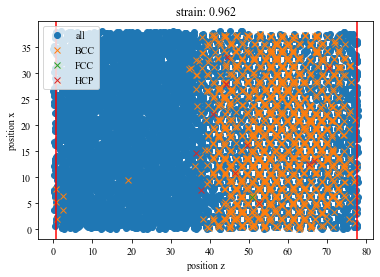

...

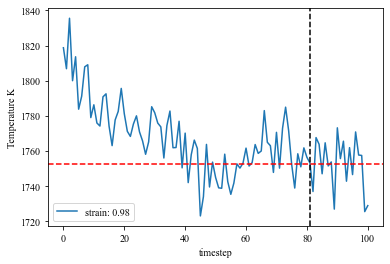

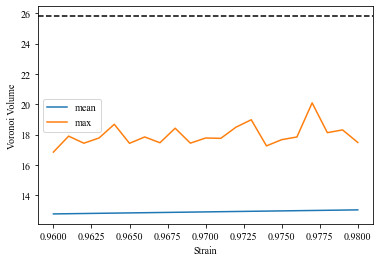

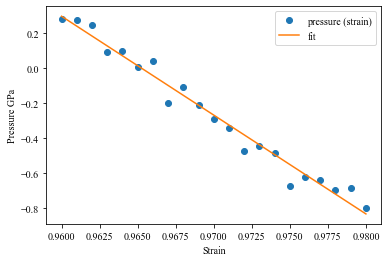

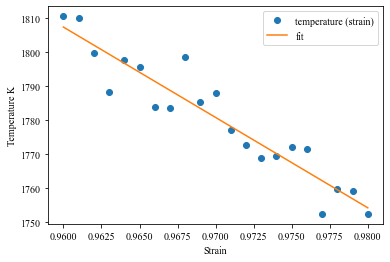

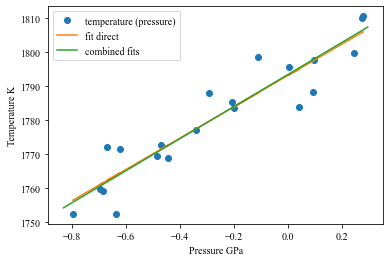

1793.16646629798 1793.4585466686353
1793.16646629798 1781.469372232489 1766.8844303631101 1796.0543141018677
{'timestep': 1, 'fit_range': 0.01, 'nve_run_time_steps': 50000, 'boundary_value': 0.25, 'ratio_boundary': 0.25, 'temperature_next': 1793.16646629798, 'center': 0.97}


The job ham_npt_solid_1793_17 was saved and received the ID: 237


The job ham_npt_liquid_high_2793_17 was saved and received the ID: 238


The job ham_npt_liquid_low_1793_17 was saved and received the ID: 239


2020-12-03 09:41:31,381 - pyiron_log - WARNING - Job 'ham_nve_0_96_1793_17_2' does not exist and cannot be loaded


The job ham_nvt_0_96_1793_17_2 was saved and received the ID: 240


2020-12-03 09:42:45,153 - pyiron_log - WARNING - Job 'ham_nve_0_961_1793_17_2' does not exist and cannot be loaded


The job ham_nvt_0_961_1793_17_2 was saved and received the ID: 241


2020-12-03 09:43:58,607 - pyiron_log - WARNING - Job 'ham_nve_0_962_1793_17_2' does not exist and cannot be loaded


The job ham_nvt_0_962_1793_17_2 was saved and received the ID: 242


2020-12-03 09:45:12,130 - pyiron_log - WARNING - Job 'ham_nve_0_963_1793_17_2' does not exist and cannot be loaded


The job ham_nvt_0_963_1793_17_2 was saved and received the ID: 243


2020-12-03 09:46:25,426 - pyiron_log - WARNING - Job 'ham_nve_0_964_1793_17_2' does not exist and cannot be loaded


The job ham_nvt_0_964_1793_17_2 was saved and received the ID: 244


2020-12-03 09:47:38,593 - pyiron_log - WARNING - Job 'ham_nve_0_965_1793_17_2' does not exist and cannot be loaded


The job ham_nvt_0_965_1793_17_2 was saved and received the ID: 245


2020-12-03 09:48:52,422 - pyiron_log - WARNING - Job 'ham_nve_0_966_1793_17_2' does not exist and cannot be loaded


The job ham_nvt_0_966_1793_17_2 was saved and received the ID: 246


2020-12-03 09:50:06,227 - pyiron_log - WARNING - Job 'ham_nve_0_967_1793_17_2' does not exist and cannot be loaded


The job ham_nvt_0_967_1793_17_2 was saved and received the ID: 247


2020-12-03 09:51:19,217 - pyiron_log - WARNING - Job 'ham_nve_0_968_1793_17_2' does not exist and cannot be loaded


The job ham_nvt_0_968_1793_17_2 was saved and received the ID: 248


2020-12-03 09:52:32,675 - pyiron_log - WARNING - Job 'ham_nve_0_969_1793_17_2' does not exist and cannot be loaded


The job ham_nvt_0_969_1793_17_2 was saved and received the ID: 249


2020-12-03 09:53:46,136 - pyiron_log - WARNING - Job 'ham_nve_0_97_1793_17_2' does not exist and cannot be loaded


The job ham_nvt_0_97_1793_17_2 was saved and received the ID: 250


2020-12-03 09:54:58,601 - pyiron_log - WARNING - Job 'ham_nve_0_971_1793_17_2' does not exist and cannot be loaded


The job ham_nvt_0_971_1793_17_2 was saved and received the ID: 251


2020-12-03 09:56:12,441 - pyiron_log - WARNING - Job 'ham_nve_0_972_1793_17_2' does not exist and cannot be loaded


The job ham_nvt_0_972_1793_17_2 was saved and received the ID: 252


2020-12-03 09:57:25,632 - pyiron_log - WARNING - Job 'ham_nve_0_973_1793_17_2' does not exist and cannot be loaded


The job ham_nvt_0_973_1793_17_2 was saved and received the ID: 253


2020-12-03 09:58:38,486 - pyiron_log - WARNING - Job 'ham_nve_0_974_1793_17_2' does not exist and cannot be loaded


The job ham_nvt_0_974_1793_17_2 was saved and received the ID: 254


2020-12-03 09:59:51,283 - pyiron_log - WARNING - Job 'ham_nve_0_975_1793_17_2' does not exist and cannot be loaded


The job ham_nvt_0_975_1793_17_2 was saved and received the ID: 255


2020-12-03 10:01:04,624 - pyiron_log - WARNING - Job 'ham_nve_0_976_1793_17_2' does not exist and cannot be loaded


The job ham_nvt_0_976_1793_17_2 was saved and received the ID: 256


2020-12-03 10:02:17,736 - pyiron_log - WARNING - Job 'ham_nve_0_977_1793_17_2' does not exist and cannot be loaded


The job ham_nvt_0_977_1793_17_2 was saved and received the ID: 257


2020-12-03 10:03:30,643 - pyiron_log - WARNING - Job 'ham_nve_0_978_1793_17_2' does not exist and cannot be loaded


The job ham_nvt_0_978_1793_17_2 was saved and received the ID: 258


2020-12-03 10:04:43,307 - pyiron_log - WARNING - Job 'ham_nve_0_979_1793_17_2' does not exist and cannot be loaded


The job ham_nvt_0_979_1793_17_2 was saved and received the ID: 259


2020-12-03 10:05:55,529 - pyiron_log - WARNING - Job 'ham_nve_0_98_1793_17_2' does not exist and cannot be loaded


The job ham_nvt_0_98_1793_17_2 was saved and received the ID: 260


The job ham_nve_0_96_1793_17_2 was saved and received the ID: 261


The job ham_nve_0_961_1793_17_2 was saved and received the ID: 262


The job ham_nve_0_962_1793_17_2 was saved and received the ID: 263


The job ham_nve_0_963_1793_17_2 was saved and received the ID: 264


The job ham_nve_0_964_1793_17_2 was saved and received the ID: 265


The job ham_nve_0_965_1793_17_2 was saved and received the ID: 266


The job ham_nve_0_966_1793_17_2 was saved and received the ID: 267


The job ham_nve_0_967_1793_17_2 was saved and received the ID: 268


The job ham_nve_0_968_1793_17_2 was saved and received the ID: 269


The job ham_nve_0_969_1793_17_2 was saved and received the ID: 270


The job ham_nve_0_97_1793_17_2 was saved and received the ID: 271


The job ham_nve_0_971_1793_17_2 was saved and received the ID: 272


The job ham_nve_0_972_1793_17_2 was saved and received the ID: 273


The job ham_nve_0_973_1793_17_2 was saved and received the ID: 274


The job ham_nve_0_974_1793_17_2 was saved and received the ID: 275


The job ham_nve_0_975_1793_17_2 was saved and received the ID: 276


The job ham_nve_0_976_1793_17_2 was saved and received the ID: 277


The job ham_nve_0_977_1793_17_2 was saved and received the ID: 278


The job ham_nve_0_978_1793_17_2 was saved and received the ID: 279


The job ham_nve_0_979_1793_17_2 was saved and received the ID: 280


The job ham_nve_0_98_1793_17_2 was saved and received the ID: 281


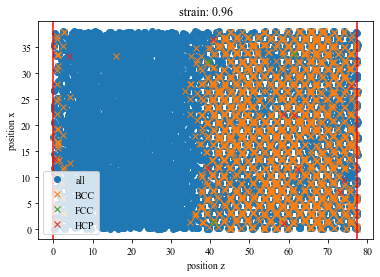

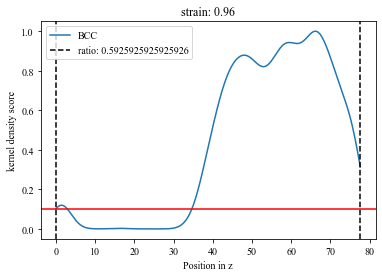

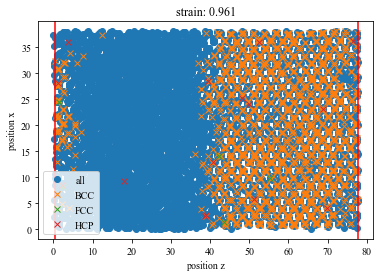

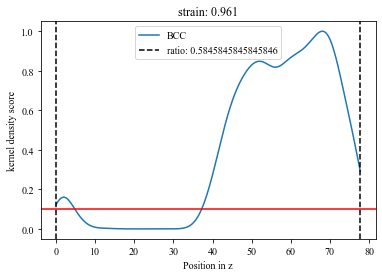

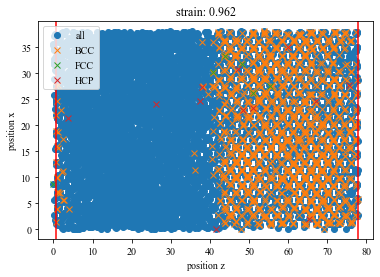

...

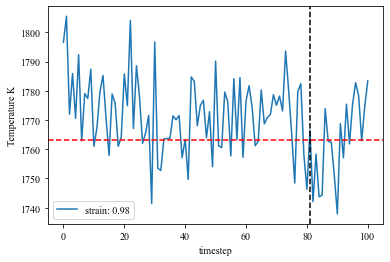

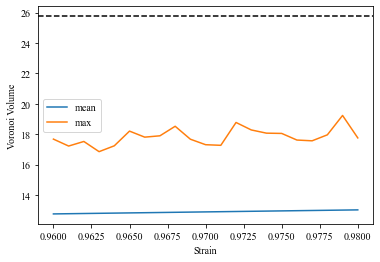

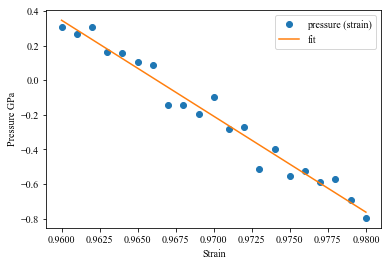

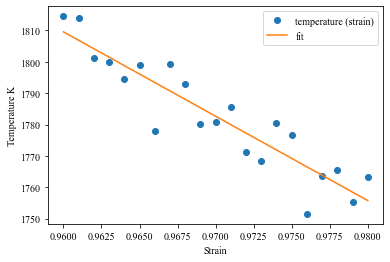

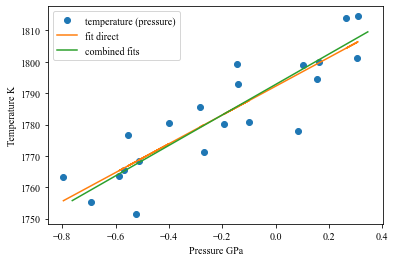

1792.2085794650131 1792.76719812991
1792.2085794650131 1783.0233570823093 1767.2646002773797 1798.782113887239
{'timestep': 1, 'fit_range': 0.01, 'nve_run_time_steps': 50000, 'boundary_value': 0.25, 'ratio_boundary': 0.25, 'temperature_next': 1792.2085794650131, 'center': 0.97}


In [36]:
temperature_estimate_lst, temperature_calculated_lst = [], []
while len(temperature_calculated_lst) < 3 or not convergence_goal_achieved and len(temperature_calculated_lst) < 10:
    temperature_estimate_lst.append(temperature_next)
    temperature_next, temperature_mean, temperature_left, temperature_right, strain_result_lst, pressure_result_lst = calc_temp_iteration(
        basis=ham_minimize_vol.get_structure().repeat([1,1,2]), 
        temperature_next=temperature_next, 
        project_parameter=project_parameter,
        timestep=timestep,
        nve_run_time_steps=nve_run_time_steps, 
        fit_range=fit_range,  
        center=center,
        debug_plot=True)
    print(temperature_next, temperature_mean, temperature_left, temperature_right)
    output = validate_convergence(pr=pr,
                                  temperature_left=temperature_left, 
                                  temperature_next=temperature_next, 
                                  temperature_right=temperature_right, 
                                  enable_iteration=enable_iteration,
                                  timestep_iter=timestep_iter,
                                  timestep_lst=project_parameter['timestep_lst'],
                                  timestep=timestep,
                                  fit_range_iter=fit_range_iter, 
                                  fit_range_lst=project_parameter['fit_range_lst'], 
                                  fit_range=fit_range, 
                                  nve_run_time_steps_iter=nve_run_time_steps_iter, 
                                  nve_run_time_steps_lst=project_parameter['nve_run_time_steps_lst'], 
                                  nve_run_time_steps=nve_run_time_steps,
                                  strain_result_lst=strain_result_lst, 
                                  pressure_result_lst=pressure_result_lst, 
                                  step_count=step_count, 
                                  step_dict=step_dict, 
                                  boundary_value=project_parameter['boundary_value'], 
                                  ratio_boundary=project_parameter['ratio_boundary'],
                                  convergence_goal=project_parameter['convergence_criterion'],
                                  output_file=output_file)
    convergence_goal_achieved, enable_iteration, step_count, step_dict, timestep, fit_range, nve_run_time_steps, boundary_value, ratio_boundary, temperature_next, center = output
    print(step_dict[step_count])
    temperature_calculated_lst.append(temperature_next)

In [37]:
if not os.path.exists(output_file):
    with open(output_file, 'w') as f:
        json.dump(step_dict, f)

In [38]:
step_dict

{0: {'temperature_next': 1695},
 1: {'timestep': 2,
  'fit_range': 0.05,
  'nve_run_time_steps': 25000,
  'boundary_value': 0.25,
  'ratio_boundary': 0.25,
  'temperature_next': 1782.2336552695308,
  'center': 0.94},
 2: {'timestep': 2,
  'fit_range': 0.01,
  'nve_run_time_steps': 20000,
  'boundary_value': 0.25,
  'ratio_boundary': 0.25,
  'temperature_next': 1794.798980794205,
  'center': 0.97},
 3: {'timestep': 1,
  'fit_range': 0.01,
  'nve_run_time_steps': 50000,
  'boundary_value': 0.25,
  'ratio_boundary': 0.25,
  'temperature_next': 1795.8466527704347,
  'center': 0.97},
 4: {'timestep': 1,
  'fit_range': 0.01,
  'nve_run_time_steps': 50000,
  'boundary_value': 0.25,
  'ratio_boundary': 0.25,
  'temperature_next': 1799.9503442479693,
  'center': 0.97},
 5: {'timestep': 1,
  'fit_range': 0.01,
  'nve_run_time_steps': 50000,
  'boundary_value': 0.25,
  'ratio_boundary': 0.25,
  'temperature_next': 1793.16646629798,
  'center': 0.97},
 6: {'timestep': 1,
  'fit_range': 0.01,
  'nv

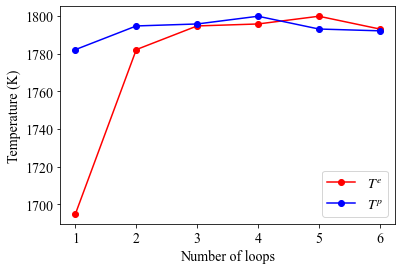

In [39]:
#plot the convergence of loop calculations
first_key = list(step_dict.keys())[-1]
second_key = 'temperature_next'
allt = [step_dict[key][second_key] for key in list(step_dict.keys())]
plt.plot(np.arange(1, len(allt)), allt[0:-1], 'ro-', label=r"$T^e$")
plt.plot(np.arange(1, len(allt)), allt[1:], 'bo-', label=r"$T^p$")
plt.legend(fontsize=14)
plt.tick_params(axis='both', labelsize=14)
plt.xlabel('Number of loops', fontsize=14)
plt.ylabel('Temperature (K)', fontsize=14)
plt.show()

In [40]:
df = pr.job_table()
df

,id,status,chemicalformula,job,subjob,projectpath,project,timestart,timestop,totalcputime,computer,hamilton,hamversion,parentid,masterid
0,1,finished,Fe4394,minimize_pos,/minimize_pos,/scratch/janssen/melt_fe/,melting/,2020-12-02 15:11:17.168762,2020-12-02 15:11:19.652444,2.0,pyiron@cmpc05#4,Lammps,0.1,NaN,None
1,2,finished,Fe4394,minimize_vol,/minimize_vol,/scratch/janssen/melt_fe/,melting/,2020-12-02 15:11:21.460277,2020-12-02 15:11:23.564191,2.0,pyiron@cmpc05#4,Lammps,0.1,NaN,None
2,3,finished,Fe4394,temp_heating_1000,/temp_heating_1000,/scratch/janssen/melt_fe/,melting/,2020-12-02 15:11:32.396949,2020-12-02 15:11:39.826188,7.0,pyiron@cmpc05#4,Lammps,0.1,NaN,None
3,4,finished,Fe4394,temp_heating_2000,/temp_heating_2000,/scratch/janssen/melt_fe/,melting/,2020-12-02 15:11:43.767872,2020-12-02 15:11:48.788897,5.0,pyiron@cmpc05#4,Lammps,0.1,NaN,None
4,5,finished,Fe4394,temp_heating_1500_0,/temp_heating_1500_0,/scratch/janssen/melt_fe/,melting/,2020-12-02 15:11:52.975781,2020-12-02 15:11:58.362292,5.0,pyiron@cmpc05#4,Lammps,0.1,NaN,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
276,277,finished,Fe8788,ham_nve_0_976_1793_17_2,/ham_nve_0_976_1793_17_2,/scratch/janssen/melt_fe/,melting/,2020-12-03 12:31:50.060299,2020-12-03 12:41:44.139944,594.0,pyiron@cmpc05#4,Lammps,0.1,256.0,None
277,278,finished,Fe8788,ham_nve_0_977_1793_17_2,/ham_nve_0_977_1793_17_2,/scratch/janssen/melt_fe/,melting/,2020-12-03 12:41:47.784624,2020-12-03 12:48:54.014823,426.0,pyiron@cmpc05#4,Lammps,0.1,257.0,None
278,279,finished,Fe8788,ham_nve_0_978_1793_17_2,/ham_nve_0_978_1793_17_2,/scratch/janssen/melt_fe/,melting/,2020-12-03 12:48:57.720386,2020-12-03 12:59:11.368632,613.0,pyiron@cmpc05#4,Lammps,0.1,258.0,None
279,280,finished,Fe8788,ham_nve_0_979_1793_17_2,/ham_nve_0_979_1793_17_2,/scratch/janssen/melt_fe/,melting/,2020-12-03 12:59:15.249820,2020-12-03 13:09:14.525964,599.0,pyiron@cmpc05#4,Lammps,0.1,259.0,None
